# TF Human Pose Keypoints and Tracking for Folk Dance Choreographies

**AUTHOR: CAMELIA CIOLAC**  
ciolac_c@inria-alumni.fr


In this mini-project we use pretrained CENTER-NET model with Tensorflow to extract keypoints of human pose and track them in order to record folk dance choreographies.

Note: for the tracking part, a GPU must be available in the runtime

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

In [2]:
from IPython.core.display import display, HTML
#display(HTML("<style>.container { width:100% !important; }</style>"))

from matplotlib.pyplot import imshow
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.patches import Rectangle, Circle
from matplotlib.offsetbox import TextArea, DrawingArea, OffsetImage, AnnotationBbox
from mpl_toolkits import mplot3d
from matplotlib import colors as mat_colors
%matplotlib inline

In [3]:
!mkdir -p "/content/gdrive/My Drive/dances"

In [4]:
!sudo apt-get install tree > /dev/null 2>&1

!sudo -H pip install --upgrade youtube-dl > /dev/null 2>&1

!sudo apt-get install --only-upgrade ffmpeg > /dev/null 2>&1

In [5]:
import pandas as pd
import numpy as np
import math
from scipy.spatial import distance

from PIL import Image as pilim
import collections as coll

import pprint

import shapely as shp
import shapely.geometry as geom

import cv2
cv2.__version__

'4.1.2'

In [6]:
import os
#logging levels : 0 = INFO , 1 = WARN , 2 = ERROR, 3 = none (not used in TF2)
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2' 

import tensorflow as tf
from tensorflow.python.lib.io import file_io
import tensorflow_hub as hub
print("TF version:", tf.__version__)

#logging level for TF2
tf.get_logger().setLevel('ERROR')

#devices discovered by TF2
physical_devices = tf.config.list_physical_devices()
for pdev in physical_devices:
  print(pdev)

TF version: 2.3.0
PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')
PhysicalDevice(name='/physical_device:XLA_CPU:0', device_type='XLA_CPU')
PhysicalDevice(name='/physical_device:XLA_GPU:0', device_type='XLA_GPU')
PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')


In [8]:
#GPU info - NVIDIA System Management Interface
!nvidia-smi 

Fri Nov 27 16:44:00 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.38       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0    27W / 250W |     10MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Download some clips and extract videoframes

### German Folk dance 1

In [103]:
#check at what quality it is available

!youtube-dl -F https://www.youtube.com/watch?v=Ne9_LHiSTuo

[youtube] Ne9_LHiSTuo: Downloading webpage
[info] Available formats for Ne9_LHiSTuo:
format code  extension  resolution note
249          webm       audio only tiny   60k , opus @ 50k (48000Hz), 1.72MiB
250          webm       audio only tiny   77k , opus @ 70k (48000Hz), 2.23MiB
140          m4a        audio only tiny  128k , m4a_dash container, mp4a.40.2@128k (44100Hz), 4.06MiB
251          webm       audio only tiny  150k , opus @160k (48000Hz), 4.23MiB
278          webm       256x144    144p   98k , webm container, vp9, 30fps, video only, 3.07MiB
160          mp4        256x144    144p  113k , avc1.4d400c, 30fps, video only, 3.49MiB
242          webm       426x240    240p  239k , vp9, 30fps, video only, 7.10MiB
133          mp4        426x240    240p  249k , avc1.4d4015, 30fps, video only, 7.71MiB
243          webm       640x360    360p  472k , vp9, 30fps, video only, 13.29MiB
134          mp4        640x360    360p  641k , avc1.4d401e, 30fps, video only, 20.16MiB
244          webm

In [107]:
%%bash --out logsdw_output --err logsdw_errors

mkdir -p /tmp/dances

cd /tmp/dances
rm -f dance1_DE.mp4

#choose the quality:   137   mp4  1920x1080  1080p 4414k , avc1.640028, 30fps, video only, 138.08MiB
youtube-dl -o "dance1_DE.%(ext)s" -f 137  https://www.youtube.com/watch?v=Ne9_LHiSTuo

In [108]:
!tree --du -h /tmp/dances

/tmp/dances
└── [138M]  dance1_DE.mp4

 138M used in 0 directories, 1 file


In [109]:
#display metadata of mp4
!ffprobe -i /tmp/dances/dance1_DE.mp4

ffprobe version 3.4.8-0ubuntu0.2 Copyright (c) 2007-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

In [110]:
%%bash  --out logscr_output --err logscr_errors

cd /tmp/dances

mkdir -p "/content/gdrive/My Drive/dances/clip1"

#extract frames starting at second 00:01:51 until second  00:02:36
q | ffmpeg -ss 00:01:51 -t 00:00:40 -i dance1_DE.mp4 -vf fps=10 "/content/gdrive/My Drive/dances/clip1/"seq1_%5d.jpg


### German Folk dance 2

In [111]:
#check at what quality it is available

!youtube-dl -F https://www.youtube.com/watch?v=Aw4xIm85low

[youtube] Aw4xIm85low: Downloading webpage
[info] Available formats for Aw4xIm85low:
format code  extension  resolution note
249          webm       audio only tiny   59k , opus @ 50k (48000Hz), 2.16MiB
250          webm       audio only tiny   86k , opus @ 70k (48000Hz), 2.85MiB
140          m4a        audio only tiny  128k , m4a_dash container, mp4a.40.2@128k (44100Hz), 5.35MiB
251          webm       audio only tiny  168k , opus @160k (48000Hz), 5.48MiB
278          webm       256x144    144p  111k , webm container, vp9, 30fps, video only, 4.23MiB
160          mp4        256x144    144p  116k , avc1.4d400c, 30fps, video only, 4.69MiB
242          webm       426x240    240p  248k , vp9, 30fps, video only, 9.67MiB
133          mp4        426x240    240p  251k , avc1.4d4015, 30fps, video only, 10.36MiB
243          webm       640x360    360p  516k , vp9, 30fps, video only, 18.56MiB
134          mp4        640x360    360p  637k , avc1.4d401e, 30fps, video only, 26.70MiB
244          web

In [112]:
%%bash --out logsdw_output --err logsdw_errors

mkdir -p /tmp/dances

cd /tmp/dances

#choose the quality:   137          mp4        1920x1080  1080p 4349k , avc1.640028, 30fps, video only, 182.29MiB
youtube-dl -o "dance2_DE.%(ext)s" -f 137  https://www.youtube.com/watch?v=Aw4xIm85low

In [113]:
!tree --du -h /tmp/dances

/tmp/dances
├── [138M]  dance1_DE.mp4
└── [182M]  dance2_DE.mp4

 320M used in 0 directories, 2 files


In [114]:
#display metadata of mp4
!ffprobe -i /tmp/dances/dance2_DE.mp4

ffprobe version 3.4.8-0ubuntu0.2 Copyright (c) 2007-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

In [ ]:
%%bash  --out logscr_output --err logscr_errors

cd /tmp/dances

mkdir -p "/content/gdrive/My Drive/dances/clip4"

#extract frames starting at second 00:03:06 until second  00:03:26
q | ffmpeg -ss 00:03:06 -t 00:00:20 -i dance2_DE.mp4 -vf fps=10 "/content/gdrive/My Drive/dances/clip4/"seq4_%5d.jpg

## Download pretrained CENTER-NET Tensorflow model

CenterNet with Hourglass backbone - Object detection model, trained on COCO 2017
https://tfhub.dev/tensorflow/centernet/hourglass_1024x1024_kpts/1

In [9]:
#inspect remote resource without download
!wget --spider https://tfhub.dev/tensorflow/centernet/hourglass_1024x1024_kpts/1?tf-hub-format=compressed

Spider mode enabled. Check if remote file exists.
--2020-11-27 16:44:12--  https://tfhub.dev/tensorflow/centernet/hourglass_1024x1024_kpts/1?tf-hub-format=compressed
Resolving tfhub.dev (tfhub.dev)... 108.177.126.113, 108.177.126.102, 108.177.126.100, ...
Connecting to tfhub.dev (tfhub.dev)|108.177.126.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://storage.googleapis.com/tfhub-modules/tensorflow/centernet/hourglass_1024x1024_kpts/1.tar.gz [following]
Spider mode enabled. Check if remote file exists.
--2020-11-27 16:44:12--  https://storage.googleapis.com/tfhub-modules/tensorflow/centernet/hourglass_1024x1024_kpts/1.tar.gz
Resolving storage.googleapis.com (storage.googleapis.com)... 173.194.79.128, 108.177.126.128, 108.177.127.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|173.194.79.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 728398808 (695M) [application/octet-stream]
Remote file exis

In [10]:
!mkdir -p /tmp/tfhub_models/center_net
!curl -L "https://tfhub.dev/tensorflow/centernet/hourglass_1024x1024_kpts/1?tf-hub-format=compressed" | tar -zxvC /tmp/tfhub_models/center_net

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
  0     0    0     0    0     0      0      0 --:--:--  0:00:01 --:--:--     0./
./saved_model.pb
  0  694M    0  402k    0     0   211k      0  0:56:06  0:00:01  0:56:05  605k./variables/
./variables/variables.data-00000-of-00001
100  694M  100  694M    0     0  34.5M      0  0:00:20  0:00:20 --:--:-- 45.5M
./variables/variables.index


In [11]:
!tree --du -h  /tmp/tfhub_models

/tmp/tfhub_models
└── [805M]  center_net
    ├── [ 60M]  saved_model.pb
    └── [744M]  variables
        ├── [744M]  variables.data-00000-of-00001
        └── [ 13K]  variables.index

 805M used in 2 directories, 3 files


## Inference with the pretrained CENTER-NET model

### Read image:

In [12]:
def get_image(file_path):
    """ read image from specified location, which can be the 
        local filesystem path or a GCP Storage blob URI"""
    with file_io.FileIO(file_path, 'rb') as f:
        im = tf.io.decode_image(f.read())
        #since we're in eager execution mode in TF, we can easily convert tensor to numpy
        im_arr = im.numpy()
    return im, im_arr

In [13]:
FOLDER_IMAGES = "/content/gdrive/My Drive/dances/"

To understand the prediction results, a concat of various human poses was prepared: normal standing ( front, lateral and back views), partial view, sitting (photos credits @ H&M) 

In [14]:
im1_tens, im1_arr = get_image(file_path = FOLDER_IMAGES + "ref_image.jpg")
print("im_tens:".ljust(20), im1_tens.shape, im1_tens.dtype, type(im1_tens))
print("im_arr:".ljust(20), im1_arr.shape, im1_arr.dtype, type(im1_arr))

#input needs to be tensor and we need to expand dims
batch_tens_inp = tf.expand_dims(im1_tens, 0)
print("batch_tens_inp:".ljust(20), batch_tens_inp.shape, batch_tens_inp.dtype)

im_tens:             (1600, 2600, 3) <dtype: 'uint8'> <class 'tensorflow.python.framework.ops.EagerTensor'>
im_arr:              (1600, 2600, 3) uint8 <class 'numpy.ndarray'>
batch_tens_inp:      (1, 1600, 2600, 3) <dtype: 'uint8'>


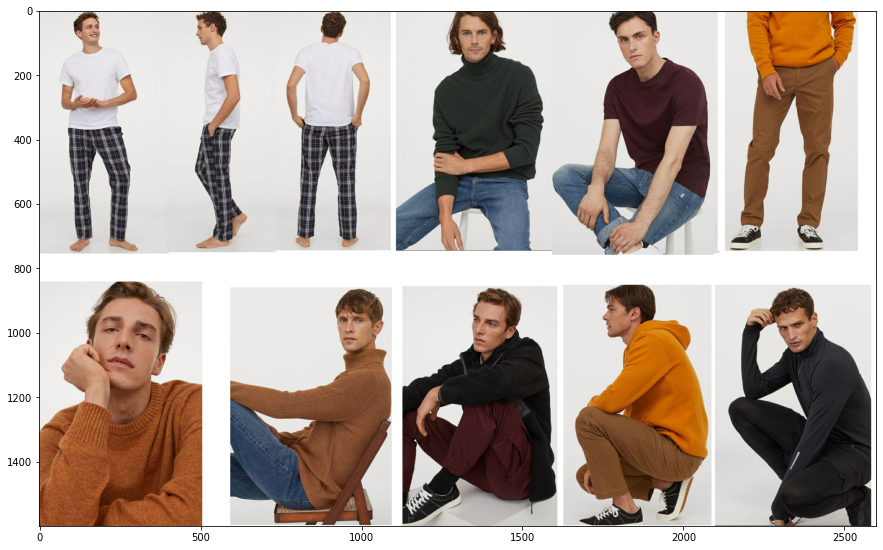

In [15]:
fig, ax = plt.subplots(1,1,  figsize=(15,15))
ax.imshow(im1_arr)

### Load the SavedModel

In [16]:
# warnings about custom gradient , but no worry if we only use it for inference
center_net_model = hub.load("/tmp/tfhub_models/center_net")

### Inspect the model's inputs and outputs

In [17]:
center_net_model.signatures

_SignatureMap({'serving_default': <ConcreteFunction signature_wrapper(input_tensor) at 0x7F2251560898>})

In [18]:
center_net_model_func = center_net_model.signatures["serving_default"]

print(type(center_net_model_func))

print("========================================================================")

#we can see here as well the input(s) and output(s)  of the saved model
print("INPUTS:")
print("===========")
#pprint.pprint(center_net_model_func.inputs)
pprint.pprint(center_net_model_func.structured_input_signature)
print("-----------------------------------------------------------------")
print("OUTPUTS:")
print("===========")
pprint.pprint(center_net_model_func.outputs)
pprint.pprint(center_net_model_func.structured_outputs)

<class 'tensorflow.python.saved_model.load._WrapperFunction'>
INPUTS:
((),
 {'input_tensor': TensorSpec(shape=(1, None, None, 3), dtype=tf.uint8, name='input_tensor')})
-----------------------------------------------------------------
OUTPUTS:
[<tf.Tensor 'Identity:0' shape=(1, 100, 4) dtype=float32>,
 <tf.Tensor 'Identity_1:0' shape=(1, 100) dtype=float32>,
 <tf.Tensor 'Identity_2:0' shape=(1, 100, 17) dtype=float32>,
 <tf.Tensor 'Identity_3:0' shape=(1, 100, 17, 2) dtype=float32>,
 <tf.Tensor 'Identity_4:0' shape=(1, 100) dtype=float32>,
 <tf.Tensor 'Identity_5:0' shape=(1,) dtype=float32>]
{'detection_boxes': TensorSpec(shape=(1, 100, 4), dtype=tf.float32, name='detection_boxes'),
 'detection_classes': TensorSpec(shape=(1, 100), dtype=tf.float32, name='detection_classes'),
 'detection_keypoint_scores': TensorSpec(shape=(1, 100, 17), dtype=tf.float32, name='detection_keypoint_scores'),
 'detection_keypoints': TensorSpec(shape=(1, 100, 17, 2), dtype=tf.float32, name='detection_keypoin

### Make prediction

In [19]:
%%time
#on gpu - with warmup delay
res_center_net = center_net_model_func(batch_tens_inp)

CPU times: user 3.56 s, sys: 732 ms, total: 4.29 s
Wall time: 9.21 s


In [20]:
%%time
#on gpu (explicitly placed computation on device)

with tf.device('/gpu:0'):
    res_center_net_ = center_net_model_func(batch_tens_inp)

CPU times: user 77.4 ms, sys: 33.9 ms, total: 111 ms
Wall time: 325 ms


In [21]:
%%time
#force to execute on cpu

with tf.device('/cpu:0'):
    res_center_net__ = center_net_model_func(batch_tens_inp)

CPU times: user 41.9 s, sys: 1.01 s, total: 42.9 s
Wall time: 23 s


In [22]:
print("num_detections    ==>", res_center_net["num_detections"], "objects detected")
print("-----------------------------------------")
print("detection_scores  ==>", res_center_net["detection_scores"].shape)
print(res_center_net["detection_scores"])

print("-----------------------------------------")
print("detection_classes ==>", res_center_net["detection_classes"].shape, res_center_net["detection_classes"].dtype)
print(res_center_net["detection_classes"])

print("-----------------------------------------")
print("detection_boxes ==>", res_center_net["detection_boxes"].shape)
print("one entity's bbox (float values are ratios of the images width and heigth):")
#the first [0] is for taking the first image's result of the batch, the second [0] is to take only one detected entity
print(res_center_net["detection_boxes"][0][0])

print("-----------------------------------------")
print("detection_keypoints ==>", res_center_net["detection_keypoints"].shape)
print("one human entity's keypoints (float values are ratios of the images width and heigth):")
print(res_center_net["detection_keypoints"][0][0])
#note: a non-human entity has all 17 keypoints zero


print("-----------------------------------------")
#for each human entity we have 17 keypoints and each suck keypoint has a confidence score
print("detection_keypoint_scores ==>", res_center_net["detection_keypoint_scores"].shape)
print("one human entity's keypoints scores:")
print(res_center_net["detection_keypoint_scores"][0][0])

num_detections    ==> tf.Tensor([100.], shape=(1,), dtype=float32) objects detected
-----------------------------------------
detection_scores  ==> (1, 100)
tf.Tensor(
[[0.9441174  0.9164203  0.8945917  0.8845141  0.87918407 0.86937237
  0.8533396  0.82500565 0.8237836  0.8053474  0.7403759  0.3883901
  0.21368277 0.1937748  0.18176904 0.15436599 0.11456931 0.10876578
  0.10675014 0.099143   0.09378413 0.08757389 0.08173571 0.08117164
  0.07704172 0.0768149  0.07675529 0.07608163 0.07339277 0.07181472
  0.06899825 0.06844357 0.0658546  0.0634793  0.06218637 0.06168851
  0.06085126 0.06033847 0.05927916 0.057925   0.05707378 0.05604522
  0.05548225 0.05370331 0.05324562 0.05039081 0.04933445 0.04923511
  0.04802333 0.04762502 0.04718202 0.04644788 0.04611188 0.04578685
  0.04469791 0.04438584 0.04426557 0.04345833 0.04293419 0.04286909
  0.04282943 0.04265999 0.04244536 0.04192529 0.04025011 0.04012381
  0.03990204 0.03983606 0.03951374 0.0393938  0.03929026 0.03920244
  0.03919517 0.03

The entities detected (based on the COCO 2017 dataset classes, are sorted in descending order of their confidence score (see detection_score above). We need to set a threshold and accept only entities with score above it.

In [23]:
def filter_confident_results(res_center_net, threshold_score = 0.2):
    """given a prediction result in res_center_net, apply threshold to retain only 
       detected entities with higher confidence score"""

    res_center_net_confident = {}
    list_scores = list(res_center_net["detection_scores"].numpy().flatten())
    list_classes = list(res_center_net["detection_classes"].numpy().flatten())

    list_indices_confident = [ii for ii in range(len(list_scores)) if list_scores[ii] >= threshold_score]

    #tf_gather - see https://www.tensorflow.org/api_docs/python/tf/gather
    #we specify axis = 1 because the 0-axis corresponds to the batch
    res_center_net_confident["detection_scores"] = tf.gather(res_center_net["detection_scores"], list_indices_confident, axis = 1)
    res_center_net_confident["detection_classes"] = tf.gather(res_center_net["detection_classes"], list_indices_confident, axis = 1)
    res_center_net_confident["detection_boxes"] = tf.gather(res_center_net["detection_boxes"], list_indices_confident, axis = 1)
    res_center_net_confident["detection_keypoints"] = tf.gather(res_center_net["detection_keypoints"], list_indices_confident, axis = 1)
    res_center_net_confident["detection_keypoint_scores"] = tf.gather(res_center_net["detection_keypoint_scores"], list_indices_confident, axis = 1)
    res_center_net_confident["num_detections"] = res_center_net_confident["detection_scores"].shape[1]

    return res_center_net_confident

In [24]:
res_center_net_confident = filter_confident_results(res_center_net, threshold_score = 0.5)

print("num_detections    ==>", res_center_net_confident["num_detections"], "objects detected")
print("-----------------------------------------")
print(res_center_net_confident["detection_scores"])
list_scores_confident = list(res_center_net_confident["detection_scores"].numpy().flatten())

print("-----------------------------------------")
print(res_center_net_confident["detection_classes"])
list_classes_confident = list(res_center_net_confident["detection_classes"].numpy().flatten())


num_detections    ==> 11 objects detected
-----------------------------------------
tf.Tensor(
[[0.9441174  0.9164203  0.8945917  0.8845141  0.87918407 0.86937237
  0.8533396  0.82500565 0.8237836  0.8053474  0.7403759 ]], shape=(1, 11), dtype=float32)
-----------------------------------------
tf.Tensor([[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]], shape=(1, 11), dtype=float32)


### Decode numeric labels to textual labels

In [25]:
!wget --quiet https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/data/mscoco_label_map.pbtxt
!head -n 10 mscoco_label_map.pbtxt

item {
  name: "/m/01g317"
  id: 1
  display_name: "person"
}
item {
  name: "/m/0199g"
  id: 2
  display_name: "bicycle"
}


In [26]:
with open('mscoco_label_map.pbtxt') as f:
    lines = f.readlines()

lines[0:10]

['item {\n',
 '  name: "/m/01g317"\n',
 '  id: 1\n',
 '  display_name: "person"\n',
 '}\n',
 'item {\n',
 '  name: "/m/0199g"\n',
 '  id: 2\n',
 '  display_name: "bicycle"\n',
 '}\n']

In [27]:
#we use list comprehension to extract the useful parts from each group of 5 lines that form an "item" 
list_dict_labels = [{"label_id": int(str(lines[5*ii + 2]).replace('"','').split(":")[1].strip()),
                     "label_name": str(lines[5*ii + 3]).replace('"','').split(":")[1].strip()} for ii in range(len(lines)//5)]
list_dict_labels[0:10]

[{'label_id': 1, 'label_name': 'person'},
 {'label_id': 2, 'label_name': 'bicycle'},
 {'label_id': 3, 'label_name': 'car'},
 {'label_id': 4, 'label_name': 'motorcycle'},
 {'label_id': 5, 'label_name': 'airplane'},
 {'label_id': 6, 'label_name': 'bus'},
 {'label_id': 7, 'label_name': 'train'},
 {'label_id': 8, 'label_name': 'truck'},
 {'label_id': 9, 'label_name': 'boat'},
 {'label_id': 10, 'label_name': 'traffic light'}]

In [28]:
#make dataframe
df_coco = pd.DataFrame(list_dict_labels)
print(df_coco.shape)

df_coco.head()

(80, 2)


,label_id,label_name
0,1,person
1,2,bicycle
2,3,car
3,4,motorcycle
4,5,airplane


In [29]:
dict_decode_coco = dict(zip(df_coco["label_id"], df_coco["label_name"]))

In [30]:
#for our result 
print("Initially (unfiltered)")
list_classes = list(res_center_net["detection_classes"].numpy().flatten())
c = coll.Counter(list_classes)
print(c)

list_classes_textual = [dict_decode_coco[el] for el in list_classes]
c2 = coll.Counter(list_classes_textual)
print(c2)

print("------------------------------------------------------------")

print("Finally (filtered)")
c3 = coll.Counter(list_classes_confident)
print(c3)

list_classes_confident_textual = [dict_decode_coco[el] for el in list_classes_confident]
c4 = coll.Counter(list_classes_confident_textual)
print(c4)

Initially (unfiltered)
Counter({1.0: 18, 62.0: 18, 75.0: 8, 31.0: 8, 43.0: 6, 15.0: 6, 77.0: 4, 41.0: 4, 63.0: 4, 37.0: 3, 70.0: 2, 40.0: 2, 34.0: 2, 39.0: 2, 84.0: 2, 33.0: 1, 44.0: 1, 90.0: 1, 65.0: 1, 27.0: 1, 73.0: 1, 49.0: 1, 67.0: 1, 54.0: 1, 53.0: 1, 88.0: 1})
Counter({'person': 18, 'chair': 18, 'remote': 8, 'handbag': 8, 'tennis racket': 6, 'bench': 6, 'cell phone': 4, 'skateboard': 4, 'couch': 4, 'sports ball': 3, 'toilet': 2, 'baseball glove': 2, 'frisbee': 2, 'baseball bat': 2, 'book': 2, 'suitcase': 1, 'bottle': 1, 'toothbrush': 1, 'bed': 1, 'backpack': 1, 'laptop': 1, 'knife': 1, 'dining table': 1, 'sandwich': 1, 'apple': 1, 'teddy bear': 1})
------------------------------------------------------------
Finally (filtered)
Counter({1.0: 11})
Counter({'person': 11})


### Visualize predictions in terms of human pose:

In [31]:
def debugged_visualization(res_center_net_confident, im1_arr):

    """visualize detected humans' keypoints as red circles together with their seqno and confidence score"""

    #tuple unpacking
    im1_height, im1_width = im1_arr.shape[0], im1_arr.shape[1]

    fig,ax = plt.subplots(1,1,figsize=(25,20))
    ax.imshow(im1_arr, alpha = 0.3)

    #take [0] because we wrapped the image in a batch
    kp_arr = res_center_net_confident["detection_keypoints"][0].numpy()
    kp_scores = res_center_net_confident["detection_keypoint_scores"][0].numpy()

    for ii in range(res_center_net_confident["num_detections"]):
        kp_entity = kp_arr[ii]
        kp_entity_scores = kp_scores[ii]

        #make coords absolute value
        kp_entity_absolute = kp_entity * np.array([im1_height, im1_width]) 
        kp_entity_absolute = np.int64(kp_entity_absolute)

        ax.scatter(x = kp_entity_absolute[:,1], 
                   y = kp_entity_absolute[:,0], 
                   c = "crimson", s=50)
        
        #annotate the seqno of the points
        list_texts = list(range(17))
        for i, txt in enumerate(list_texts):
            ax.annotate(txt, (kp_entity_absolute[:,1][i], kp_entity_absolute[:,0][i]),
                        size=20)
            
        #annotate the confidence score (rounded to first decimal) of the points 
        list_texts = ["(%.1f)"%(el) for el in list(kp_entity_scores)]
        for i, txt in enumerate(list_texts):
            ax.annotate(txt, (kp_entity_absolute[:,1][i], 15 + kp_entity_absolute[:,0][i]),
                        size=10)
    


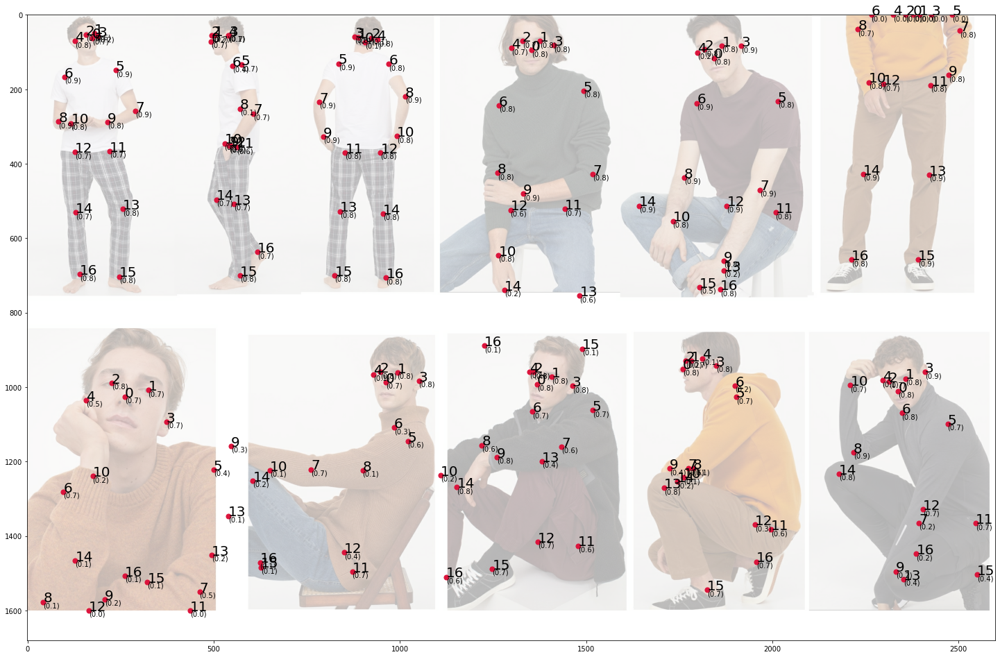

In [32]:
debugged_visualization(res_center_net_confident, im1_arr)

**Take-aways:** 
- 0 is the center of face, 
- 1 and 2 are the eyes, 
- 3 and 4 are the ears, 
- 5 and 6 are the shoulders, 
- 7 and 8 are the arms, 
- 9 and 10 are the hands, 
- 11 and 12 are the hips, 
- 13 and 14 are the knees, 
- 15 and 16 are the feet

The left side of the body has odd numbers, while the right side of the body has even numbers. Note that this is preserved even when the back is visible,

For the cases when the body is partially visible, the confidence score of some of these keypoints is very low. Nevertheless the CENTER-NET model tries to predict all 17 keypoints for each human identified (head to feet even if only upper body is visible for example).

-----------------------

Summarize the processing so far and apply it on a folk dance image:




In [33]:
def make_confident_prediction(img_filename):
    """read image from img_filename, make a batch and perform inference, filtering detected objects 
       based on entity-level confidence score """

    ii = int(img_filename[img_filename.index("seq") + 3 : img_filename.index("_")])
    im1_tens, im1_arr = get_image(file_path = FOLDER_IMAGES + "clip{}/".format(ii) + img_filename)
    #input needs to be tensor and we need to expand dims
    batch_tens_inp = tf.expand_dims(im1_tens, 0)
    #make prediction
    res_center_net = center_net_model_func(batch_tens_inp)
    #filter based on confidence scores
    res_center_net_confident = filter_confident_results(res_center_net, threshold_score = 0.4)

    return res_center_net_confident, im1_arr

In [34]:
res_center_net_confident, im1_arr = make_confident_prediction(img_filename = "seq4_00131.jpg")

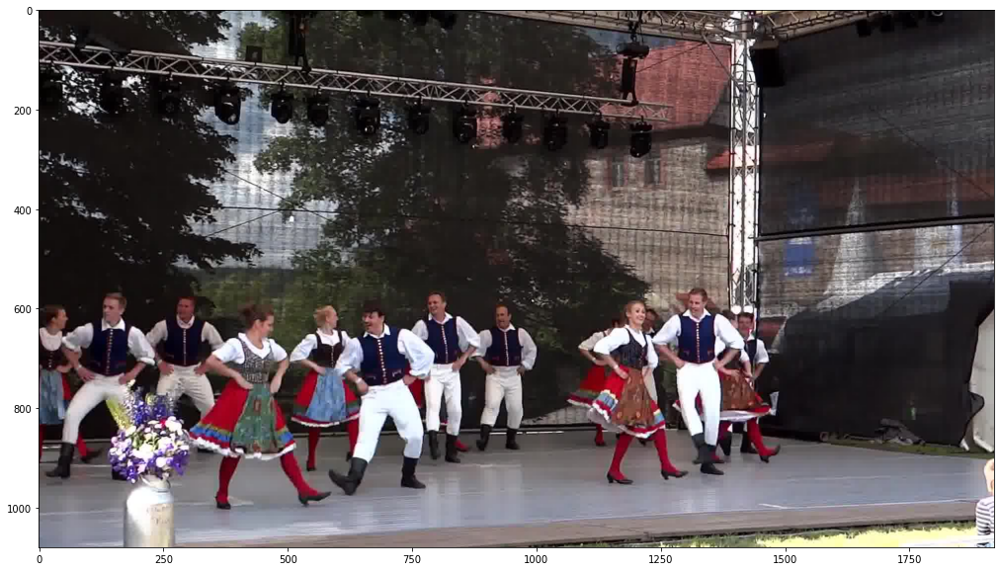

In [35]:
fig, ax = plt.subplots(1,1, figsize = (20,10))
ax.imshow(im1_arr)

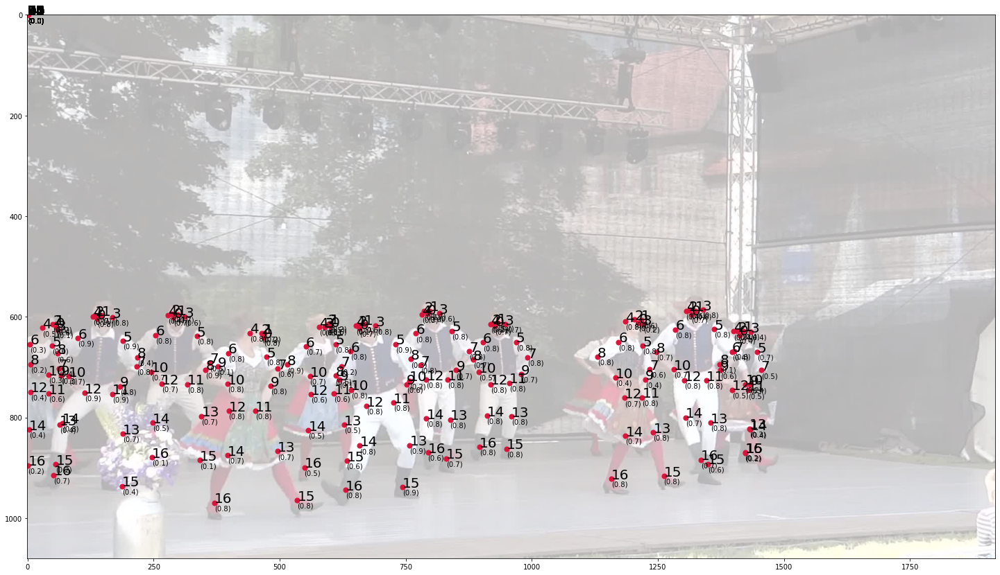

In [36]:
debugged_visualization(res_center_net_confident, im1_arr)

In [37]:
dict_pose_semantics = {  "left_ankle_to_knee": [13,15],
                        "left_knee_to_hip": [13,11],
                        "right_ankle_to_knee":[16,14],
                        "right_knee_to_hip": [14,12],
                        "left_hip_to_shoulder":[11,5],
                        "right_tip_to_shoulder":[12,6],
                        "belt": [12,11],
                        "left_palm_to_elbow": [9,7],
                        "left_elbow_to_shoulder":[7,5],
                        "right_palm_to_elbow":[10,8],
                        "right_elbow_to_shoulder":[8,6],
                        "shoulders": [6,5],
                        #"left_shoulder_to_ear":[5,3],
                        #"right_shoulder_to_ear":[6,4],
                        #"ears": [3,4]
                        }

Note: the points crowded at the top-left corner (0,0) are due to non-human entities detected by CENTER-NET in this image and which have by convention all of their 17 keypoints at (0,0)

### Post-processing inference results

Next, we move towards more elaborated post-processing of the results:

In [38]:
 def post_process_keypoints(res_center_net_confident, im1_size, threshold_confidence_kp = 0.45, selected_indices = []):
    """postprocess prediction results in res_center_net_confident to differentiate left and right sides of the body
    and to filter keypoints based on their confidence score"""

    #tuple unpacking
    im1_height, im1_width = im1_size

    list_keypoints_all_entities = []

    #take [0] because we wrapped the image in a batch
    kp_arr = res_center_net_confident["detection_keypoints"][0].numpy()
    kp_scores = res_center_net_confident["detection_keypoint_scores"][0].numpy()

    if len(selected_indices) == 0:
        list_indices = range(res_center_net_confident["num_detections"])
    else:
        list_indices = selected_indices

    for ii in list_indices:
        kp_entity = kp_arr[ii]
        kp_entity_scores = kp_scores[ii]
        #if sum is non-zero it means we have a human
        if np.sum(kp_entity) != 0:
            dict_keypoints_entity = {}

            #make coords absolute value
            kp_entity_absolute = kp_entity * np.array([im1_height, im1_width]) 
            kp_entity_absolute = np.int64(kp_entity_absolute)

            #confident indices
            indices_confident = np.argwhere(kp_entity_scores > threshold_confidence_kp).flatten()

            #rearrange, even and uneven indexes
            kp_entity_absolute_even = kp_entity_absolute[::2]
            kp_entity_absolute_odd = kp_entity_absolute[1::2]

            #filter keypoints to keep only confident ones for dislay
            kp_scores_even = kp_entity_scores[::2]
            kp_scores_odd = kp_entity_scores[1::2]
            indices_even_confident = np.argwhere(kp_scores_even > threshold_confidence_kp).flatten()
            indices_odd_confident = np.argwhere(kp_scores_odd > threshold_confidence_kp).flatten()
            
            dict_keypoints_entity["keypoints_relative_coords"] = kp_entity  
            dict_keypoints_entity["keypoints_absolute_coords"] = kp_entity_absolute
            dict_keypoints_entity["indices_confident"] = indices_confident 
            dict_keypoints_entity["keypoints_even_side"] = kp_entity_absolute_even  
            dict_keypoints_entity["keypoints_odd_side"] = kp_entity_absolute_odd
            dict_keypoints_entity["indices_even_side_confident"] = indices_even_confident 
            dict_keypoints_entity["indices_odd_side_confident"] = indices_odd_confident
            list_keypoints_all_entities.append(dict_keypoints_entity)

    return list_keypoints_all_entities

In [39]:
im1_height = im1_arr.shape[0]
im1_width = im1_arr.shape[1]

list_keypoints_all_entities = post_process_keypoints(res_center_net_confident, 
                                                     im1_size = (im1_height, im1_width),
                                                     threshold_confidence_kp = 0.3)
print("-----------------------------------------")
#example of one entity
pprint.pprint(list_keypoints_all_entities[0])

-----------------------------------------
{'indices_confident': array([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16]),
 'indices_even_side_confident': array([0, 1, 3, 4, 5, 6, 7, 8]),
 'indices_odd_side_confident': array([0, 1, 2, 3, 4, 5, 6, 7]),
 'keypoints_absolute_coords': array([[604, 138],
       [597, 147],
       [597, 134],
       [601, 168],
       [599, 130],
       [648, 189],
       [642, 100],
       [698, 217],
       [673,  59],
       [738, 183],
       [718,  82],
       [753, 168],
       [751, 113],
       [832, 189],
       [811,  69],
       [936, 188],
       [914,  52]]),
 'keypoints_even_side': array([[604, 138],
       [597, 134],
       [599, 130],
       [642, 100],
       [673,  59],
       [718,  82],
       [751, 113],
       [811,  69],
       [914,  52]]),
 'keypoints_odd_side': array([[597, 147],
       [601, 168],
       [648, 189],
       [698, 217],
       [738, 183],
       [753, 168],
       [832, 189],
       [936, 188]]),
 'key

### Visualize connected and distinguished left and right body sides

We can visualize the visible parts of the body poses:

In [40]:
def visualize_body_pose_single_person(dict_keypoints_entity, ax, color_dict = {"left":"red", "right":"blue"}):

    #first plot the lines
    pose_lines = list(dict_pose_semantics.values())     
    kp_entity_absolute = dict_keypoints_entity["keypoints_absolute_coords"]
    indices_confident = dict_keypoints_entity["indices_confident"]
    for pose_line in pose_lines:
        start = pose_line[0]
        end = pose_line[1]
        if (start in indices_confident) and (end in indices_confident):
            ax.plot([kp_entity_absolute[start,1], kp_entity_absolute[end,1]], 
                    [kp_entity_absolute[start,0], kp_entity_absolute[end,0]], 
                    c = "black", linewidth=2)


    #then plot the points, colored by left-right side
    kp_entity_absolute_even = dict_keypoints_entity["keypoints_even_side"]
    kp_entity_absolute_odd = dict_keypoints_entity["keypoints_odd_side"]
    indices_even_confident = dict_keypoints_entity["indices_even_side_confident"]
    indices_odd_confident = dict_keypoints_entity["indices_odd_side_confident"]
    #except indices on head keypoints (first 2 on left side, first 3 on right side)
    indices_even_confident = indices_even_confident[indices_even_confident > 2]
    indices_odd_confident = indices_odd_confident[indices_odd_confident > 1]

    #scatter the confident points, except those on head
    kp_entity_absolute_even_confident = kp_entity_absolute_even[indices_even_confident]
    kp_entity_absolute_odd_confident = kp_entity_absolute_odd[indices_odd_confident]    
    
    try:
        ax.scatter(x = kp_entity_absolute_even_confident[:,1], 
                    y = kp_entity_absolute_even_confident[:,0], 
                    c = color_dict["left"], s=60)
    except:
        None
    try:
        ax.scatter(x = kp_entity_absolute_odd_confident[:,1], 
                    y = kp_entity_absolute_odd_confident[:,0],
                    c = color_dict["right"], s=60)
    except:
        None
    


In [41]:
def visualize_body_poses(list_keypoints_all_entities, im1_arr, color_dict = {"left":"red", "right":"blue"}):
    
    fig, ax = plt.subplots(1,1, figsize = (20,20))
    ax.imshow(im1_arr, alpha = 0.3)

    for dict_keypoints_entity in list_keypoints_all_entities:
        visualize_body_pose_single_person(dict_keypoints_entity, ax, color_dict)

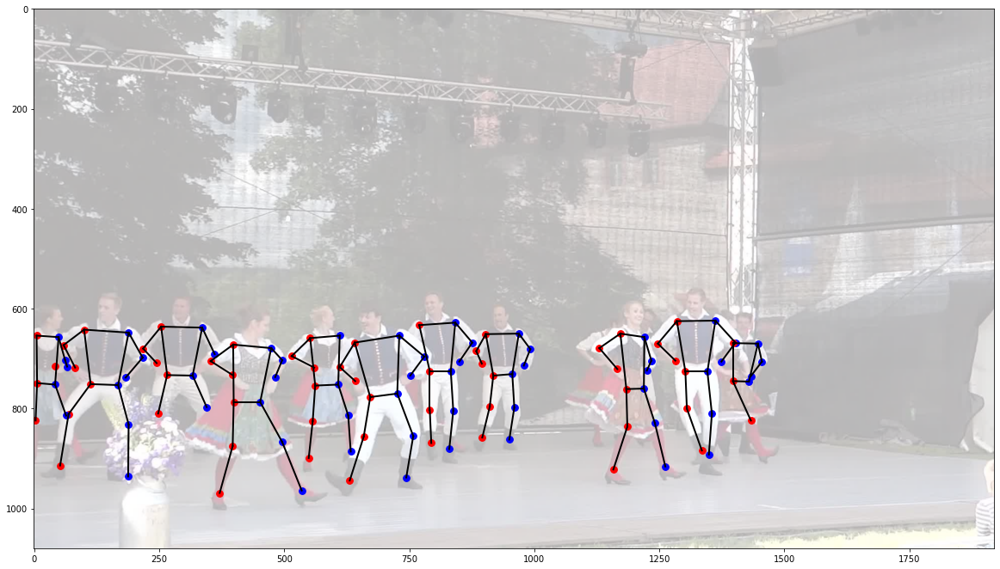

In [42]:
visualize_body_poses(list_keypoints_all_entities, im1_arr)

**ANOTHER ILLUSTRATION:**

In [43]:
def end2end_inference_and_visualization(img_filename, threshold_confidence_kp= 0.3, vis_flag = False):

    res_center_net_confident, im_arr = make_confident_prediction(img_filename)
    im_height = im_arr.shape[0]
    im_width = im_arr.shape[1]

    list_keypoints_all_entities = post_process_keypoints(res_center_net_confident, 
                                                        im1_size = (im_height, im_width),
                                                        threshold_confidence_kp = threshold_confidence_kp)
    if vis_flag is True:
        visualize_body_poses(list_keypoints_all_entities, im_arr)

    dict_res = {"res_center_net_confident" : res_center_net_confident, 
                "list_keypoints_all_entities" : list_keypoints_all_entities}
    return dict_res

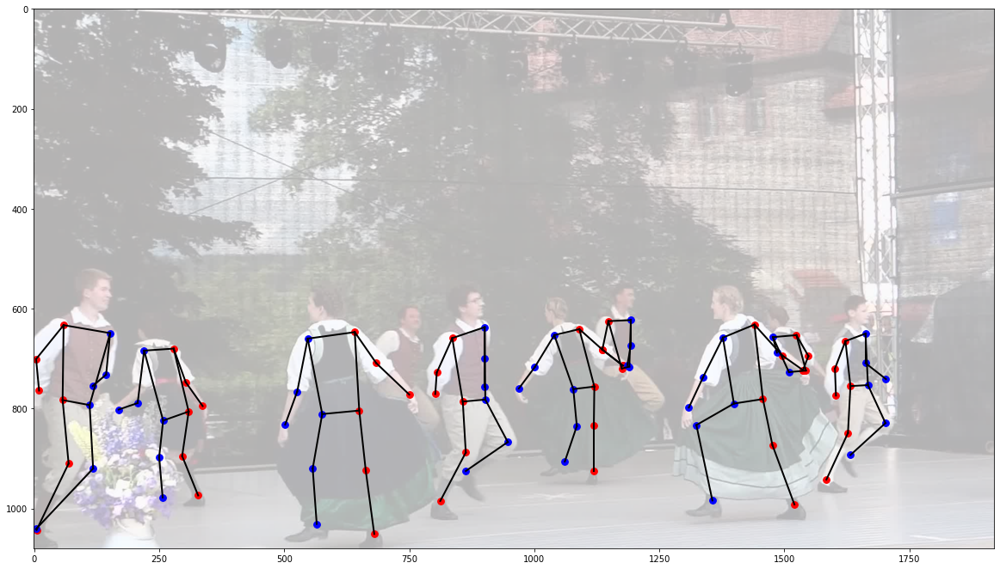

In [44]:
_ = end2end_inference_and_visualization(img_filename = "seq1_00295.jpg",
                                        threshold_confidence_kp = 0.1,
                                        vis_flag = True)

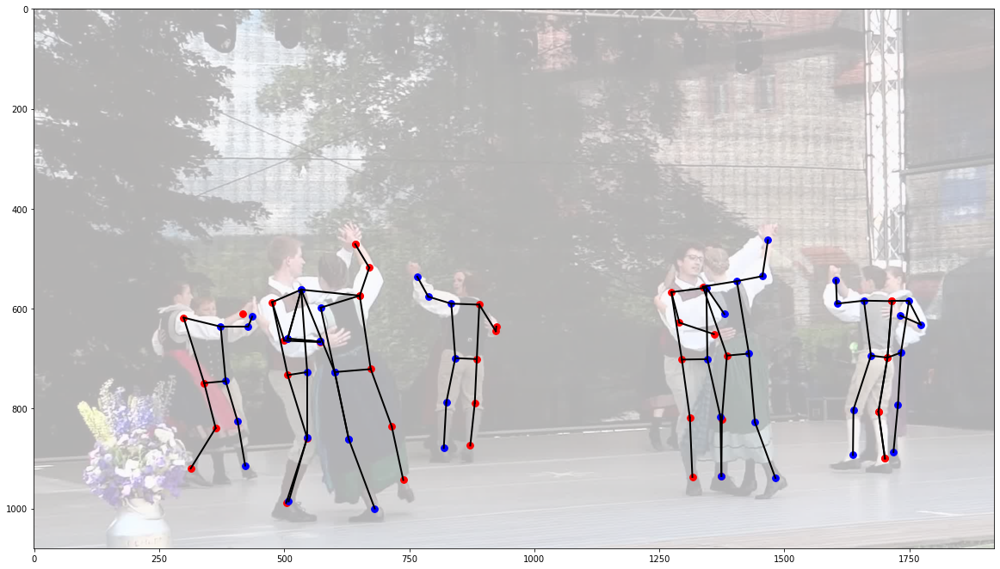

In [45]:
_ = end2end_inference_and_visualization(img_filename = "seq1_00324.jpg", 
                                        threshold_confidence_kp = 0.2,
                                        vis_flag = True)

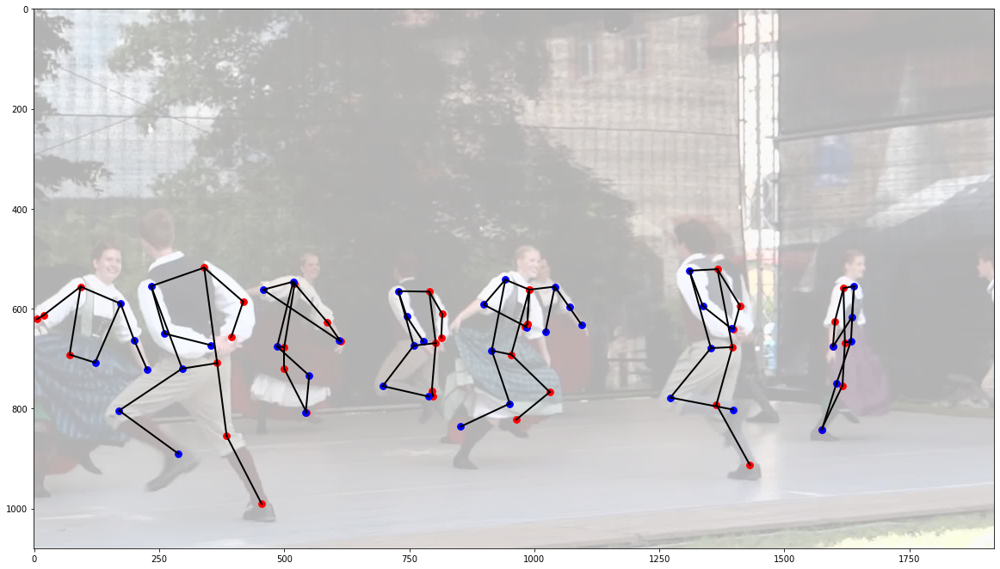

In [56]:
_ = end2end_inference_and_visualization(img_filename = "seq1_00012.jpg", 
                                        threshold_confidence_kp = 0.1,
                                        vis_flag = True)

Note:  the large costume skirts caused less confident and sometimes wrong predictions for their part

## Instance tracking across sequence of videoframes

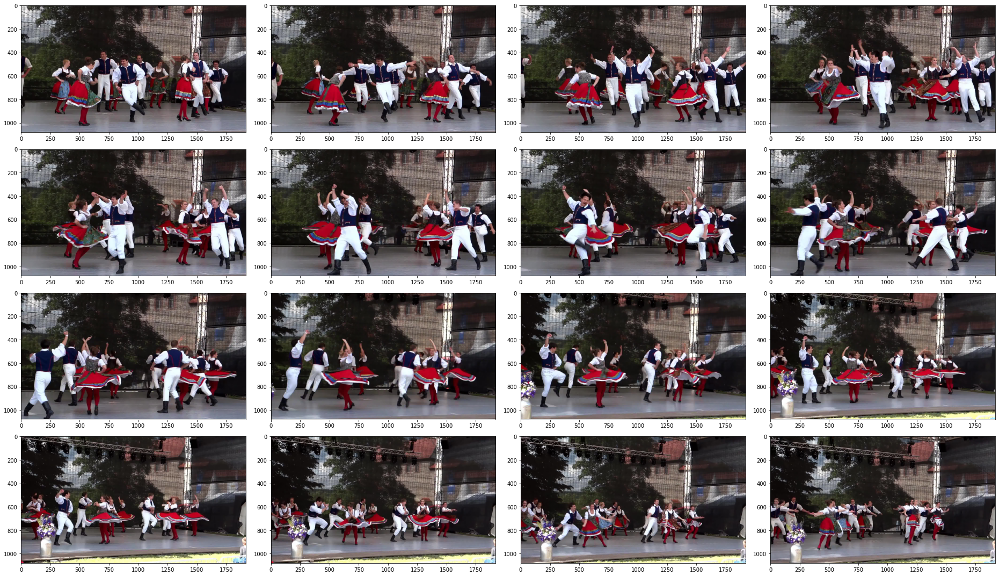

In [57]:
list_img = ["seq4_%05d.jpg"%(ii) for ii in range(80,150)]

num_rows_plot = 4
num_cols_plot = 4
fig = plt.figure(figsize = (26,15))
for ii in range(num_rows_plot * num_cols_plot):
    #for plotting, show every 3rd pose take 3*ii
    im_ = pilim.open(FOLDER_IMAGES + "clip4/" + list_img[3*ii])
    ax = fig.add_subplot(num_rows_plot,num_cols_plot,ii+1)
    ax.imshow(np.array(im_))

fig.tight_layout()

Comment: there are several challenges in tracking a dancer:
- the costumes make it difficult to use features based on appearence; 
- the dancer is not visible continuously (occlusion may occur);
- camera zoom in/out lead to change of scale of the instance tracked (see last 6 plotted in grid)


We experiment tracking with a dancer from the foreground (because those in background rows are even harder to track)

In [58]:
def prepare_startframe(img_filename, debug_flag = False):
    dict_startframe = end2end_inference_and_visualization(img_filename = img_filename,
                                        threshold_confidence_kp = 0.3,
                                        vis_flag = False)
    
    ii = int(img_filename[img_filename.index("seq") + 3 : img_filename.index("_")])
    im1_tens, im1_arr = get_image(file_path = FOLDER_IMAGES + "clip{}/".format(ii) + img_filename)

    res_center_net_confident = dict_startframe["res_center_net_confident"]
    im1_height, im1_width = im1_arr.shape[0], im1_arr.shape[1]
    bboxes_scaled = res_center_net_confident["detection_boxes"][0] * np.array([im1_height, im1_width, im1_height, im1_width])


    if debug_flag is True:
        print("bboxes found for all detected humans:")

        #take [0] because we passed a batch with 1 image
        print(res_center_net_confident["detection_boxes"][0])

        print("bboxes found for all detected humans, scaled to image size:")
        print(bboxes_scaled)

    return bboxes_scaled, im1_arr

In [59]:
def visualize_bboxes(im1_arr, bboxes_scaled):

    im1_arr_cpy = im1_arr.copy()
    fig,ax = plt.subplots(1,1,figsize = (15,10))

    for ii in range(bboxes_scaled.shape[0]):
        bbox = bboxes_scaled[ii]
        #tuple unpacking
        ymin, xmin, ymax, xmax = bbox
        cv2.rectangle(img = im1_arr_cpy, 
                            pt1 = (xmin, ymin), pt2 = (xmax, ymax),
                            color = (0, 255, 255), thickness = 4
                            )
        #write on top of the rectangle the number of the instance
        ax.text(xmin, ymin, str(ii), size=10, rotation=0.0,
                ha="left", va="center",
                bbox=dict(boxstyle="round",
                        ec="red",
                        fc=mat_colors.to_rgba('white'),
                        ),
                zorder = 2
                )
        
    
    ax.imshow(im1_arr_cpy, zorder = 1)


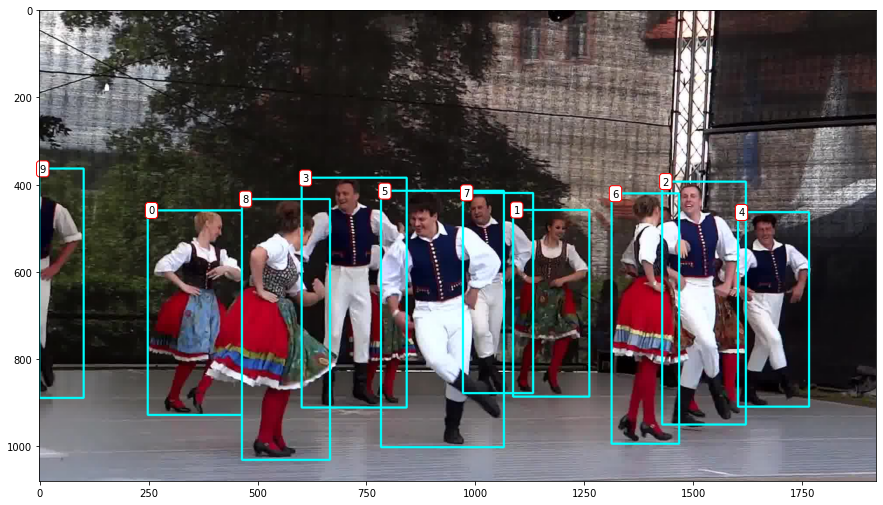

In [60]:
bboxes_scaled_startframe, im1_arr_startframe = prepare_startframe(img_filename = list_img[0])
visualize_bboxes(im1_arr_startframe, bboxes_scaled_startframe)

Notes from [1]  and [2] about tracking algorithms :

- KCF overall good, yet it looses track if full occlusion of tracked object
- MEDIANFLOW overall good, yet occlusion-related issues
- MOSSE better, deals with many variations (scale, lighting) and copes with occlusions by a pause & resume approach 
- CSRT better, idem MOSSE plus more accurate 


[1] https://www.pyimagesearch.com/2018/07/30/opencv-object-tracking/  
[2] https://www.learnopencv.com/object-tracking-using-opencv-cpp-python/ 

### Single dancer tracking

In [61]:
print([el for el in dir(cv2.TrackerCSRT) if el[0]!="_"])
print("-------------------------------------------------------")
help(cv2.TrackerCSRT_create)
print("-------------------------------------------------------")
help(cv2.TrackerCSRT.init)
print("-------------------------------------------------------")

['clear', 'create', 'empty', 'getDefaultName', 'init', 'read', 'save', 'setInitialMask', 'update', 'write']
-------------------------------------------------------
Help on built-in function TrackerCSRT_create:

TrackerCSRT_create(...)
    TrackerCSRT_create() -> retval
    .   @brief Constructor
    .     @param parameters CSRT parameters TrackerCSRT::Params

-------------------------------------------------------
Help on method_descriptor:

init(...)
    init(image, boundingBox) -> retval
    .   @brief Initialize the tracker with a known bounding box that surrounded the target
    .       @param image The initial frame
    .       @param boundingBox The initial bounding box
    .   
    .       @return True if initialization went succesfully, false otherwise

-------------------------------------------------------


In [62]:
def track_single_dancer(tracked_dancer, bboxes_scaled_startframe, 
                        im1_arr_startframe, list_img, do_keypoints = True):
    """Track a single dancer in a sequence of images in list_img,
       using OpenCV's TrackerCSRT, whose initialization is based on
       a region of interest provided by the tracked_dancer -th element in bboxes_scaled_startframe.
       Optionally, the inference with CENTER-NET can also be performed on each frame in the sequence
     """

    list_seq_bboxes = []

    BBOX_tracked_dancer =  bboxes_scaled_startframe[tracked_dancer]
    print("initial bbox of tracked dancer:", BBOX_tracked_dancer, end = " ---> ")
    BBOX_tracked_dancer_arr = BBOX_tracked_dancer.numpy()
    BBOX_tracked_dancer_arr = BBOX_tracked_dancer_arr.astype(np.int32)

    #the bbox should be a tuple and should consist of xmin,ymin,width,height
    BBOX_tracked_dancer_tup = (BBOX_tracked_dancer_arr[1], BBOX_tracked_dancer_arr[0],
                            BBOX_tracked_dancer_arr[3] - BBOX_tracked_dancer_arr[1],
                            BBOX_tracked_dancer_arr[2] - BBOX_tracked_dancer_arr[0])
    print(BBOX_tracked_dancer_tup)

    trackker = cv2.TrackerCSRT_create()
    status = trackker.init(image = im1_arr_startframe, boundingBox = BBOX_tracked_dancer_tup)
    if status is True:
        #for each image in list_img
        for ii in range(1,len(list_img)):
            if do_keypoints is False:
                #just read next videoframe from image file
                img_filename = list_img[ii]
                ii = int(img_filename[img_filename.index("seq") + 3 : img_filename.index("_")])
                im_tens_next, im_arr_next = get_image(file_path = FOLDER_IMAGES + "clip{}/".format(ii) + img_filename)
            else:
                #do inference with CENTER-NET in Tensorflow
                res_center_net_confident, im_arr_next = make_confident_prediction(img_filename = list_img[ii])
                im1_height, im1_width = im_arr_next.shape[0], im_arr_next.shape[1]
                bboxes_scaled = res_center_net_confident["detection_boxes"][0] * np.array([im1_height, im1_width, im1_height, im1_width])

            #now do the opencv tracking
            try:
                (status2, bbox_tracked) = trackker.update(im_arr_next)
                x, y, w, h = bbox_tracked

                if (status2 is True) and (do_keypoints is True):
                    #find the instance whose predicted bbox with CENTER-NET overlaps the most the bbox predicted with the trackker
                    list_candidates_detected_for_tracked_bbox = find_matches_centernet_vs_tracker(bboxes_scaled, bbox_tracked)

                    list_seq_bboxes.append({
                        "status": status2, 
                        "bbox_tracked": bbox_tracked,      #here it would be [xmin ymin, w,h] of floats
                        "bbox_tracked_2": [int(y),int(x),int(y+h),int(x+w)],   #here we've set as [ymin, xmin, ymax, xmax] of int
                        "inference_result": res_center_net_confident,
                        "centernet_bboxes_matching_tracked_bbox": list_candidates_detected_for_tracked_bbox
                        })
                    
                else:
                    list_seq_bboxes.append({
                        "status": status2, 
                        "bbox_tracked": bbox_tracked,      #here it would be [xmin ymin, w,h] of floats
                        "bbox_tracked_2": [int(y),int(x),int(y+h),int(x+w)],   #here we've set as [ymin, xmin, ymax, xmax] of int
                        "inference_result":None, 
                        "centernet_bboxes_matching_tracked_bbox": None})
            except Exception as e:
                print(e)

    successes = [el["status"] for el in list_seq_bboxes]
    print(coll.Counter(successes))
    matched_bboxes = [1 for el in list_seq_bboxes if el["centernet_bboxes_matching_tracked_bbox"] is not None]
    print("number of times inference bbox matched with tracked bbox:", sum(matched_bboxes))

    return list_seq_bboxes



In [63]:
def find_matches_centernet_vs_tracker(bboxes_scaled, bbox_tracked):
    """ Given the predictions results bboxes_scaled of CENTER-NET and the bbox_tracked proposed by the tracker,
       identify the matches between prediction bbox(es) and the tracked bbox"""

    #create a shapely polygon for the bbox returned by the tracker
    x, y, w, h = bbox_tracked
    geom_bbox_tracked =  geom.Polygon([[x,y],[x,y+h],[x+w,y+h],[x+w,y],[x,y]])

    #for each instance detected with CENTER-NET, create a shapely polygon for its bbox
    list_candidates_detected_for_tracked_bbox = [] 
    for iii in range(bboxes_scaled.shape[0]):
        ymin, xmin, ymax, xmax = bboxes_scaled[iii]
        geom_bbox_predicted = geom.Polygon([[xmin,ymin],[xmin,ymax],[xmax,ymax],[xmax,ymin],[xmin,ymin]]) 

        if geom_bbox_predicted.intersects(geom_bbox_tracked):
            #if the 2 bboxes intersect, chck how large is their overlap relative to both of their area
            inters_predicted_vs_tracked = geom_bbox_predicted.intersection(geom_bbox_tracked)
            inters_predicted_vs_tracked_area = inters_predicted_vs_tracked.area
            ratio_overlap_of_predicted_area = inters_predicted_vs_tracked.area / geom_bbox_predicted.area
            ratio_overlap_of_tracked_area = inters_predicted_vs_tracked.area / geom_bbox_tracked.area

            if (ratio_overlap_of_predicted_area > 0.3) and (ratio_overlap_of_tracked_area > 0.3):
                dict_match = {"idx": iii,
                              "bbox_predicted_scaled":  bboxes_scaled[iii].numpy().astype(np.int32), #from tensor
                              "ratio_overlap_of_predicted_area": ratio_overlap_of_predicted_area,
                              "ratio_overlap_of_tracked_area": ratio_overlap_of_tracked_area}
                list_candidates_detected_for_tracked_bbox.append(dict_match)                           
                

    return list_candidates_detected_for_tracked_bbox


In [65]:
list_seq_bboxes_dancer5 = track_single_dancer(tracked_dancer = 5, 
                                               bboxes_scaled_startframe = bboxes_scaled_startframe, 
                                               im1_arr_startframe = im1_arr_startframe, 
                                               list_img = list_img)

initial bbox of tracked dancer: tf.Tensor([ 414.97092  784.7453  1002.05084 1066.9125 ], shape=(4,), dtype=float32) ---> (784, 414, 282, 588)
Counter({True: 69})
number of times inference bbox matched with tracked bbox: 69


In [66]:
list_seq_bboxes_dancer8 = track_single_dancer(tracked_dancer = 8, 
                                               bboxes_scaled_startframe = bboxes_scaled_startframe, 
                                               im1_arr_startframe = im1_arr_startframe, 
                                               list_img = list_img)

initial bbox of tracked dancer: tf.Tensor([ 433.2516   465.44058 1031.4017   667.27527], shape=(4,), dtype=float32) ---> (465, 433, 202, 598)
Counter({True: 69})
number of times inference bbox matched with tracked bbox: 69


In [67]:
#example of an item in returned result list

#temporary modify print options for np array
with np.printoptions(threshold=5):
    pprint.pprint(list_seq_bboxes_dancer8[-1])


{'bbox_tracked': (686.6348876953125,
                  577.4744262695312,
                  144.2607879638672,
                  427.069091796875),
 'bbox_tracked_2': [577, 686, 1004, 830],
 'centernet_bboxes_matching_tracked_bbox': [{'bbox_predicted_scaled': array([594, 676, 987, 832], dtype=int32),
                                             'idx': 2,
                                             'ratio_overlap_of_predicted_area': 0.9232423554944115,
                                             'ratio_overlap_of_tracked_area': 0.9206835689071187}],
 'inference_result': {'detection_boxes': <tf.Tensor: shape=(1, 16, 4), dtype=float32, numpy=
array([[[0.5026858 , 0.55960053, 0.89144284, 0.6638227 ],
        [0.51590943, 0.23829831, 0.8625367 , 0.32061577],
        [0.55021155, 0.3521825 , 0.9142814 , 0.43356508],
        ...,
        [0.5474242 , 0.39168966, 0.59958714, 0.41661704],
        [0.21682501, 0.6256143 , 0.2866093 , 0.64957404],
        [0.5528785 , 0.14322145, 0.59171706, 0.

In [69]:
def visualize_tracking_single(list_seq_bboxes_dancer, list_img, bbox_color):
    """visualize the bboxes of the tracker (rect colored in color bbox_color) and those of the prediction (rect colored in yellow)"""

    num_rows_plot = 4
    num_cols_plot = 4
    fig = plt.figure(figsize = (26,15))
    for ii in range(num_rows_plot * num_cols_plot):
        ax = fig.add_subplot(num_rows_plot,num_cols_plot,ii+1)
        #we'll plot every 3rd videoframe (to have some notable movement since we took 10 frames per second)
        img_filename = list_img[ii * 3]
        iii = int(img_filename[img_filename.index("seq") + 3 : img_filename.index("_")])
        im_tens_, im_arr_ = get_image(file_path = FOLDER_IMAGES + "clip{}/".format(iii) + img_filename)
           
        tracked_result = list_seq_bboxes_dancer[ii *3]    
        if (ii > 0) and (tracked_result["status"] is True):
            bbox_tracked_2 = tracked_result["bbox_tracked_2"]
            ymin, xmin, ymax, xmax = bbox_tracked_2
            cv2.rectangle(img = im_arr_, 
                        pt1 = (xmin, ymin), pt2 = (xmax, ymax),
                        color = bbox_color, thickness = 10
                        )  
             
            matched_bbox_predictions = tracked_result["centernet_bboxes_matching_tracked_bbox"]
            if matched_bbox_predictions is not None:
                for matched_prediction in matched_bbox_predictions:
                    ymin, xmin, ymax, xmax = matched_prediction["bbox_predicted_scaled"]
                    cv2.rectangle(img = im_arr_, 
                                pt1 = (xmin, ymin), pt2 = (xmax, ymax),
                                color = (255,255, 0), thickness = 10
                                ) 
                      
        ax.imshow(np.array(im_arr_))


    fig.tight_layout()

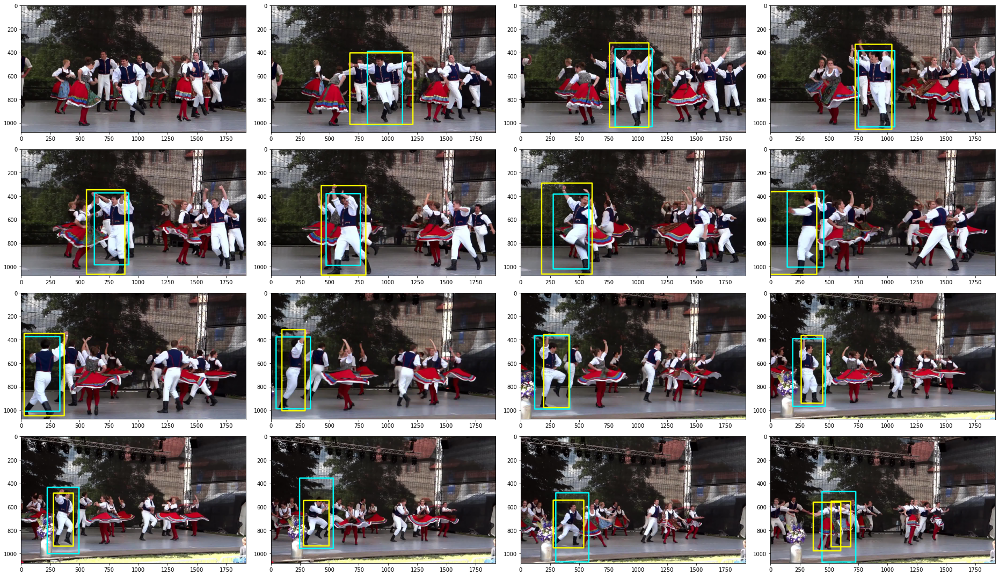

In [70]:
visualize_tracking_single(list_seq_bboxes_dancer5, list_img, bbox_color = (0,255,255))

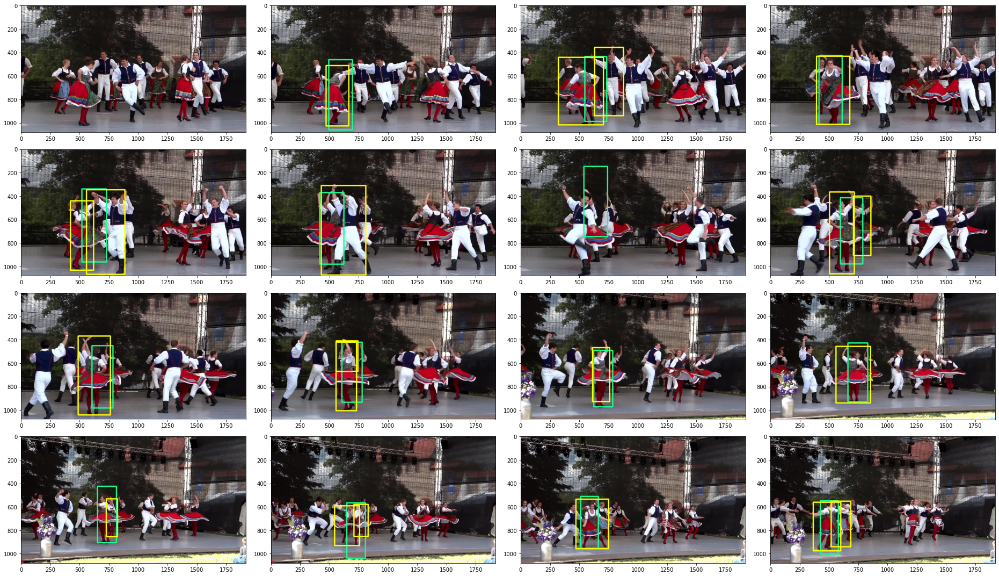

In [73]:
visualize_tracking_single(list_seq_bboxes_dancer8, list_img, bbox_color = (20, 255, 142))

We get good results, even when a zoom-out is performed on camera and even when the tracked dancer's view is temporarily occluded by another dancer.

Regarding the match between the tracked bbox result and the corresponding bbox from the set of detected instances with CENTER-NET, there are some challenges as visualized above, especially when occlusion of views. In those cases, supplementary post-processing would be beneficial, to filter based on keypoints' visibility.



###  Multiple dancers simultaneous tracking

On this occasion we track 2 dancers simultaneously (yet, each has his/her own tracker) and we investigate the tracker's behaviour when the dancer exits the view for a short time at the edge of the sccene.

In [74]:
list_img = ["seq1_%05d.jpg"%(ii) for ii in range(239,290)]

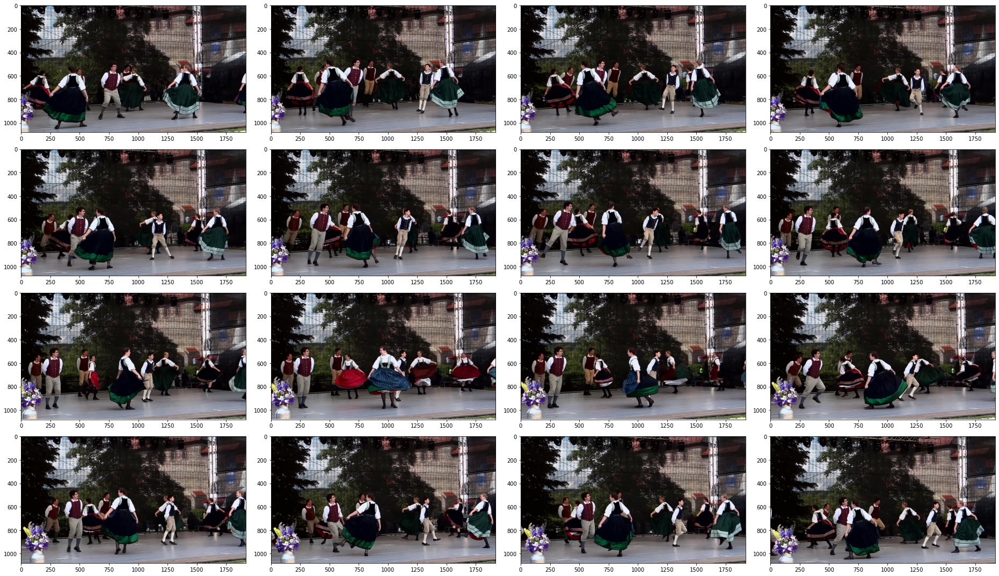

In [75]:
num_rows_plot = 4
num_cols_plot = 4
fig = plt.figure(figsize = (26,15))
for ii in range(num_rows_plot * num_cols_plot):
    #for plotting, show every 3rd pose take 3*ii
    im_ = pilim.open(FOLDER_IMAGES + "clip1/" + list_img[3 * ii])
    ax = fig.add_subplot(num_rows_plot,num_cols_plot,ii+1)
    ax.imshow(np.array(im_))

fig.tight_layout()

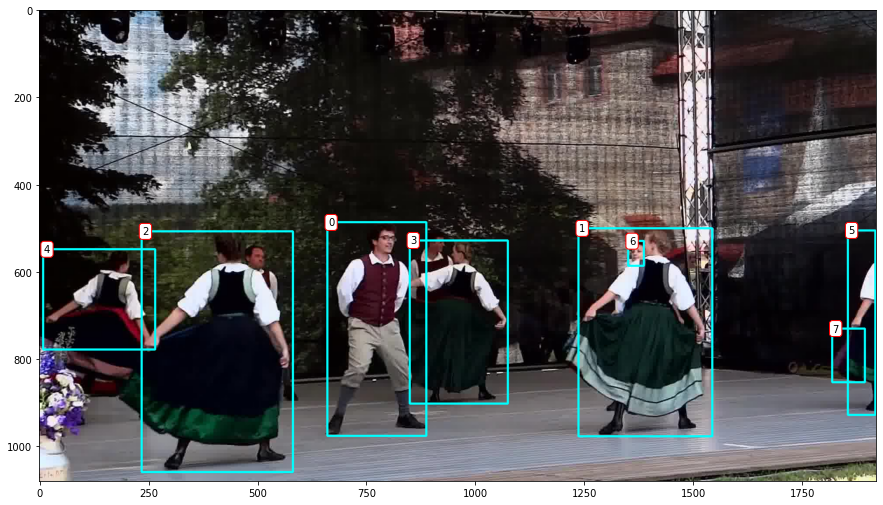

In [76]:
bboxes_scaled_startframe, im1_arr_startframe = prepare_startframe(img_filename = list_img[0])
visualize_bboxes(im1_arr_startframe, bboxes_scaled_startframe)

Note: we'll track dancers with indices 0 and 1

In [77]:
help(cv2.MultiTracker_create)
print("-------------------------------------------------------")


Help on built-in function MultiTracker_create:

MultiTracker_create(...)
    MultiTracker_create() -> retval
    .   * \brief Returns a pointer to a new instance of MultiTracker

-------------------------------------------------------


In [78]:
def track_multiple_dancers(list_tracked_dancers, bboxes_scaled_startframe, im1_arr_startframe, list_img):
    """Track a multiple dancers with OpenCV"""

    #now for each dancer tracked we'll have an entry in a dict that stores its list_seq_bboxes
    dict_perdancer_list_seq_bboxes = {}

    multi_tracker = cv2.MultiTracker_create()

    #add a tracker for each dancer
    for tracked_dancer in list_tracked_dancers:
        #initialize with empty list
        dict_perdancer_list_seq_bboxes[tracked_dancer] = []

        #preparre its bbox
        BBOX_tracked_dancer =  bboxes_scaled_startframe[tracked_dancer]
        print("initial bbox of tracked dancer:", BBOX_tracked_dancer, end = " ---> ")
        BBOX_tracked_dancer_arr = BBOX_tracked_dancer.numpy()
        BBOX_tracked_dancer_arr = BBOX_tracked_dancer_arr.astype(np.int32)

        #the bbox should be a tuple and should consist of xmin,ymin,width,height
        BBOX_tracked_dancer_tup = (BBOX_tracked_dancer_arr[1], BBOX_tracked_dancer_arr[0],
                                BBOX_tracked_dancer_arr[3] - BBOX_tracked_dancer_arr[1],
                                BBOX_tracked_dancer_arr[2] - BBOX_tracked_dancer_arr[0])
        print(BBOX_tracked_dancer_tup)

        #create a tracker 
        dancer_tracker = cv2.TrackerCSRT_create()
        #instead of init on tracker, we now do:
        multi_tracker.add(dancer_tracker, im1_arr_startframe, BBOX_tracked_dancer_tup)


    #now iterate through list of images and the multitracker updates all its member trackes at once
    for ii in range(1,len(list_img)):
        #just read next videoframe from image file
        img_filename = list_img[ii]
        ii = int(img_filename[img_filename.index("seq") + 3 : img_filename.index("_")])
        im1_tens_next, im1_arr_next = get_image(file_path = FOLDER_IMAGES + "clip{}/".format(ii) + img_filename)
       
        #now do the opencv tracking
        try:
            (status2, bboxes_tracked) = multi_tracker.update(im1_arr_next)

            for jj, bbox_tracked in enumerate(bboxes_tracked):
                x, y, w, h = bbox_tracked

                dancer_updated = list_tracked_dancers[jj]
                dict_perdancer_list_seq_bboxes[dancer_updated].append({
                        "status": status2, 
                        "bbox_tracked": bbox_tracked,      #here it would be [xmin ymin, w,h] of floats
                        "bbox_tracked_2": [int(y),int(x),int(y+h),int(x+w)],   #here we've set as [ymin, xmin, ymax, xmax] of int
                        "inference_result":None, 
                        "centernet_bboxes_matching_tracked_bbox": None})
        except Exception as e:
            print(e)


    return dict_perdancer_list_seq_bboxes

In [79]:
dict_perdancer_list_seq_bboxes = track_multiple_dancers(
                                    list_tracked_dancers = [0,1], 
                                    bboxes_scaled_startframe = bboxes_scaled_startframe, 
                                    im1_arr_startframe = im1_arr_startframe, 
                                    list_img = list_img)

initial bbox of tracked dancer: tf.Tensor([486.86127 661.70233 976.31177 888.171  ], shape=(4,), dtype=float32) ---> (661, 486, 227, 490)
initial bbox of tracked dancer: tf.Tensor([ 500.4954 1237.489   977.4796 1544.8457], shape=(4,), dtype=float32) ---> (1237, 500, 307, 477)


In [ ]:
#note: we could view just for one dancer as before:

list_seq_bboxes_dancer0 = dict_perdancer_list_seq_bboxes[0]
visualize_tracking_single(list_seq_bboxes_dancer0, list_img, bbox_color = (0,255,255))

In [85]:
def visualize_tracking_multiple(dict_perdancer_list_seq_bboxes, list_img, dict_bbox_color):
    """visualize the bboxes of the tracker (rect colored in color bbox_color) and those of the prediction (rect colored in yellow)"""

    num_rows_plot = 4
    num_cols_plot = 4
    fig = plt.figure(figsize = (26,15))
    for ii in range(num_rows_plot * num_cols_plot):
        ax = fig.add_subplot(num_rows_plot,num_cols_plot,ii+1)
        #we'll plot every 3rd videoframe (to have some notable movement since we took 10 frames per second)
        img_filename = list_img[ii * 3]
        iii = int(img_filename[img_filename.index("seq") + 3 : img_filename.index("_")])
        im_tens_, im_arr_ = get_image(file_path = FOLDER_IMAGES + "clip{}/".format(iii) + img_filename)
        
        for tracked_dancer in dict_perdancer_list_seq_bboxes.keys():
            tracked_result = dict_perdancer_list_seq_bboxes[tracked_dancer][ii *3]    
            if (ii > 0) and (tracked_result["status"] is True):
                bbox_tracked_2 = tracked_result["bbox_tracked_2"]
                ymin, xmin, ymax, xmax = bbox_tracked_2
                cv2.rectangle(img = im_arr_, 
                            pt1 = (xmin, ymin), pt2 = (xmax, ymax),
                            color = dict_bbox_color[tracked_dancer], thickness = 10
                            )  
                        
        ax.imshow(np.array(im_arr_))


    fig.tight_layout()

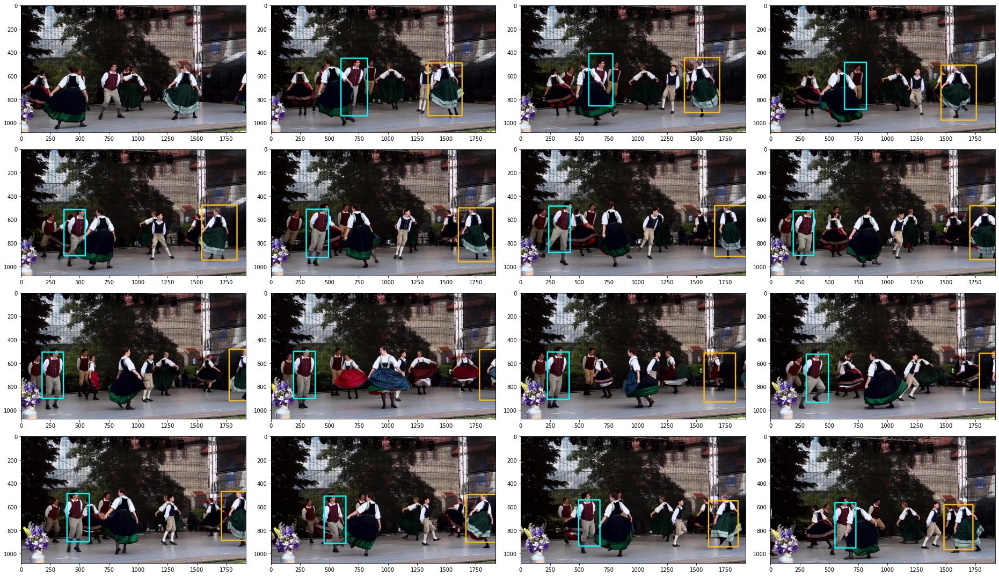

In [86]:
visualize_tracking_multiple(dict_perdancer_list_seq_bboxes, 
                            list_img, 
                            dict_bbox_color = {0: (0,255,255), 1: (250, 189, 20)})

Great! It recovers after the dancer re-enters the scene.